<html>
<body>
<h1 style = "color:blue"> Classify 10, 20 & 50 cent coins into two different categories</h1>

<h2 style = "color:red"> Abstract: </h2>
<p>The goal of this notebook is to build a convNN clasification using Tensor Flow library that is desinged to classify a given image of an euro coin into three different categories:.</p>
<p> a) Categorie 0 = 10 cents. </p>
<p> b) Categorie 1 = 20 cents. </p>
<p> c) Categorie 2 = 50 cents.

<h2 style = "color:red"> Dataset: </h2>
<p>The dataset employed in the training process is given by the Euro Coin dataset.</p>
</body>
</html>


In [1]:
import os, cv2, random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from coins_utils import *

TRAIN_DIR = 'CandidateDataSet2/resized_150_yuv_RAW/50centVs20centVs10cent/'

ROWS = 150
COLS = 150
CHANNELS = 3

images_full = [TRAIN_DIR+i for i in os.listdir(TRAIN_DIR) if '.jpg' in i]
random.shuffle(images_full)
n_images = len(images_full)
print("Number of images in full dataset "+str(n_images))
print("------------------------------------")


#Splitting of the input dataset into train, validation and test set.
train_to_full = 0.6 # Fraction of images used for training
validation_to_full = 0.8 # Fraction of images used for validation
train_to_full_index = int(n_images*train_to_full)
validation_to_full_index = int(n_images*validation_to_full)

#train_images = sorted(images_full[:train_to_full_index])
#validation_images =  sorted(images_full[train_to_full_index:validation_to_full_index])
#test_images =  sorted(images_full[validation_to_full_index:])

train_images = images_full[:train_to_full_index]
validation_images =  images_full[train_to_full_index:validation_to_full_index]
test_images =  images_full[validation_to_full_index:]

n_train_images = len(train_images)
n_validation_images = len(validation_images)
n_test_images = len(test_images)

print("Total number of train images "+str(n_train_images))
print("Total number of validation images "+str(n_validation_images))
print("Total number of test images "+str(n_test_images))
if n_train_images+n_validation_images+n_test_images - n_images != 0:
    print("Warning, there is a problem in the splitting of images")

train,maxTrain,minTrain = prep_data_nomean(train_images, ROWS = ROWS, COLS = COLS, colorSpace = "YUV")
validation = prep_data_nomean_test(validation_images, maxTrain, minTrain, ROWS = ROWS, COLS = COLS, colorSpace = "YUV")
test = prep_data_nomean_test(test_images, maxTrain, minTrain, ROWS = ROWS, COLS = COLS, colorSpace = "YUV")

#trainPrint = prep_data(train_images, ROWS = ROWS, COLS = COLS, colorSpace = "YUV")
#validationPrint = prep_data(validation_images, ROWS = ROWS, COLS = COLS, colorSpace = "YUV")
#testPrint = prep_data(test_images, ROWS = ROWS, COLS = COLS, colorSpace = "YUV")

#To make them easier to operate in future
train_images_name = [i.split('/')[-1] for i in train_images]
validation_images_name = [i.split('/')[-1] for i in validation_images]
test_images_name = [i.split('/')[-1] for i in test_images]
print(len(train_images_name), len(validation_images_name), len(test_images_name))

Using TensorFlow backend.


Number of images in full dataset 6768
------------------------------------
Total number of train images 4060
Total number of validation images 1354
Total number of test images 1354
Processed 0 of 4060
Processed 1000 of 4060
Processed 2000 of 4060
Processed 3000 of 4060
Processed 4000 of 4060
Processed 0 of 1354
Processed 1000 of 1354
Processed 0 of 1354
Processed 1000 of 1354
4060 1354 1354


# Getting the LABELS

In [2]:
## read the labels.
labels = pd.read_csv(TRAIN_DIR+'/labels_50centVs20centVs10cent.csv')

labels_train_df = labels[labels["FileName"].isin(train_images_name)]
labels_validation_df = labels[labels["FileName"].isin(validation_images_name)]
labels_test_df = labels[labels["FileName"].isin(test_images_name)]


#Example get the CoinType field and create array with labels (This is not very efficient...)
#iloc is there because for some reason it won't give me values with 'CoinType'.
nb_classes = 3
labels_train_nocategorical = []
for kitem in train_images_name:
        labels_train_nocategorical.append(labels[labels["FileName"] == kitem].iloc[0][3])   
labels_train_nocategorical= np.array(labels_train_nocategorical)
    
labels_validation_nocategorical = []
for kitem in validation_images_name:
        labels_validation_nocategorical.append(labels[labels["FileName"] == kitem].iloc[0][3]) 
labels_validation_nocategorical= np.array(labels_validation_nocategorical)


labels_test_nocategorical = []
for kitem in test_images_name:
        labels_test_nocategorical.append(labels[labels["FileName"] == kitem].iloc[0][3])     
labels_test_nocategorical= np.array(labels_test_nocategorical)


#Convert to categorical labels (vectors)
from keras.utils import np_utils
labels_train = np_utils.to_categorical(labels_train_nocategorical, nb_classes)
labels_validation = np_utils.to_categorical(labels_validation_nocategorical, nb_classes)
labels_test = np_utils.to_categorical(labels_test_nocategorical, nb_classes)

# Sanity check, we are reading everything properly

P70216-134319_Candidate_11_150_Brightness_0.jpg
This is 10 cent
(150, 150, 3)


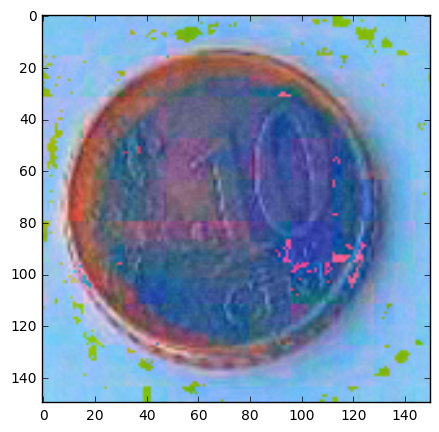

P70210-173627_Candidate_12_150_Brightness_0.jpg
This is 20 cent
(150, 150, 3)


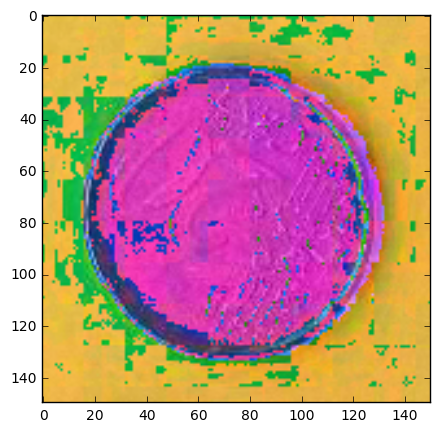

P70216-133802_Candidate_8_150_Brightness_-25.jpg
This is 10 cent
(150, 150, 3)


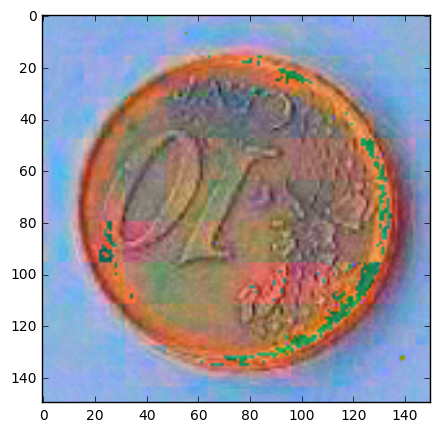

P70216-134504_Candidate_4_150_Brightness_-25.jpg
This is 10 cent
(150, 150, 3)


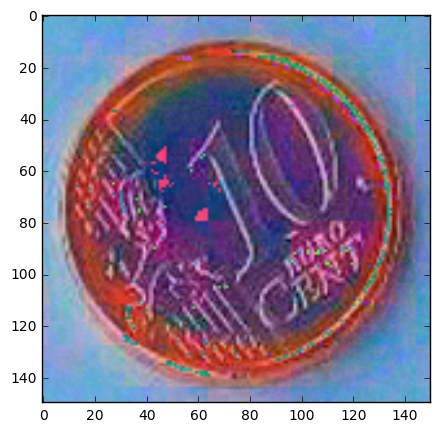

P70210-165611_Candidate_24_150_Brightness_-25.jpg
This is 50 cent
(150, 150, 3)


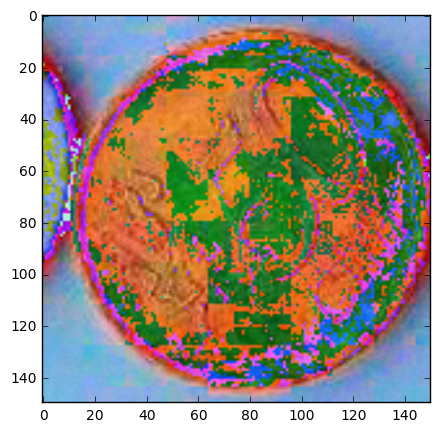

P70210-172744_Candidate_13_150_Brightness_0.jpg
This is 20 cent
(150, 150, 3)


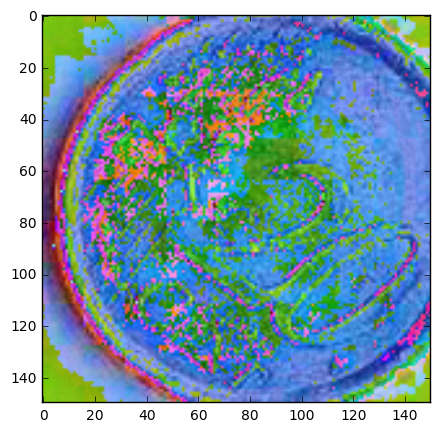

P70210-172818_Candidate_12_150_Brightness_25.jpg
This is 20 cent
(150, 150, 3)


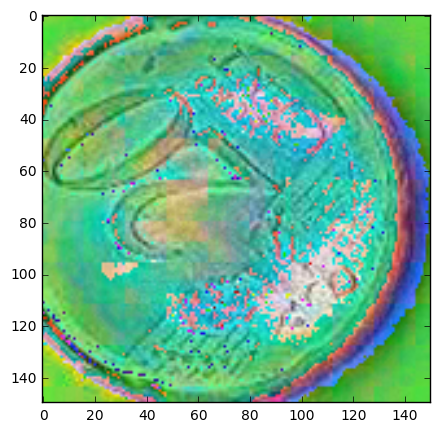

P70216-134608_Candidate_21_150_Brightness_-25.jpg
This is 10 cent
(150, 150, 3)


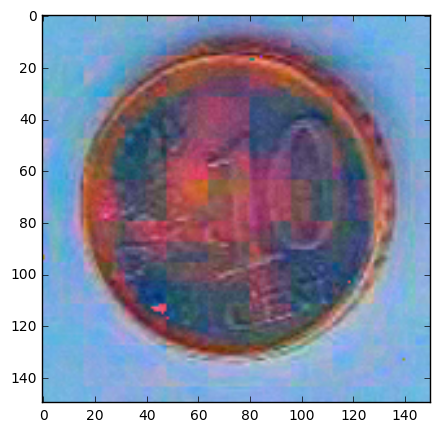

P70216-134014_Candidate_1_150_Brightness_-25.jpg
This is 10 cent
(150, 150, 3)


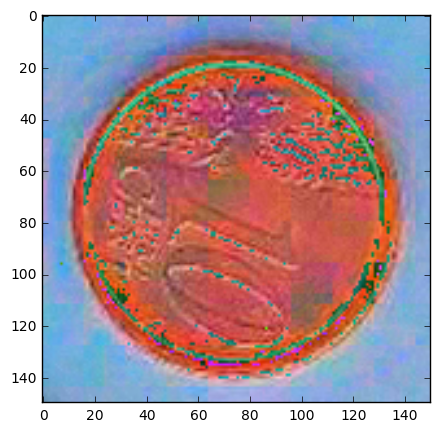

P70216-134342_Candidate_8_150_Brightness_25.jpg
This is 10 cent
(150, 150, 3)


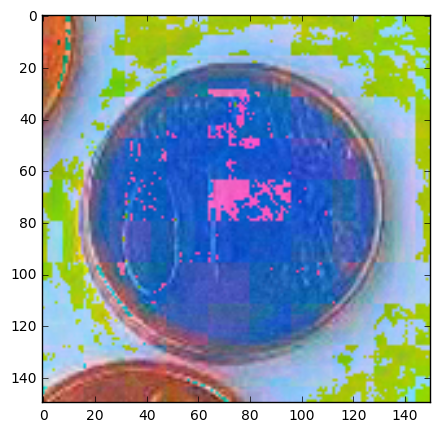

P70216-134839_Candidate_3_150_Brightness_25.jpg
This is 10 cent
(150, 150, 3)


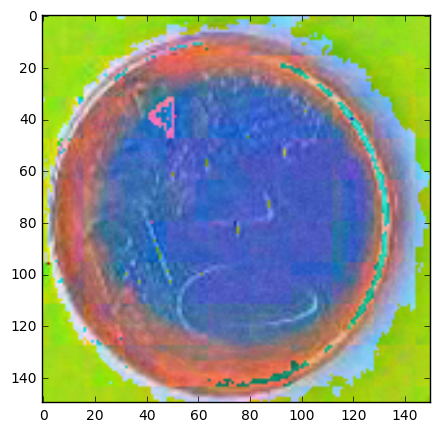

P70210-165944_Candidate_9_150_Brightness_25.jpg
This is 50 cent
(150, 150, 3)


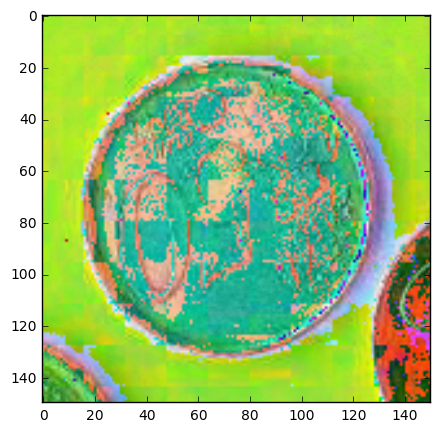

P70210-172921_Candidate_20_150_Brightness_25.jpg
This is 20 cent
(150, 150, 3)


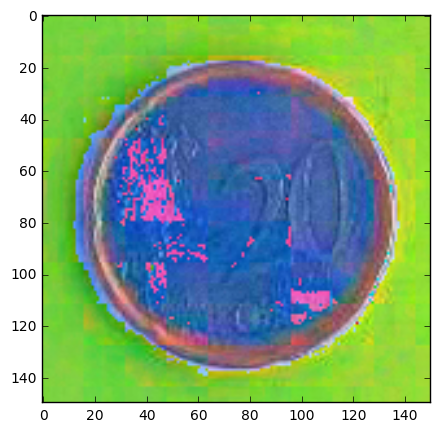

P70216-134259_Candidate_3_150_Brightness_-25.jpg
This is 10 cent
(150, 150, 3)


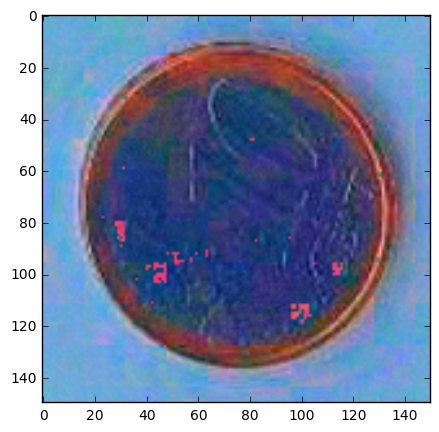

P70210-170036_Candidate_12_150_Brightness_-25.jpg
This is 50 cent
(150, 150, 3)


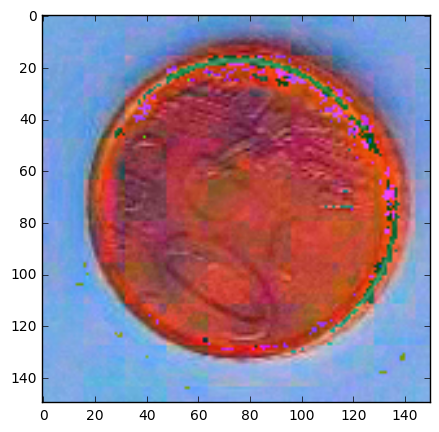

P70216-134243_Candidate_13_150_Brightness_0.jpg
This is 10 cent
(150, 150, 3)


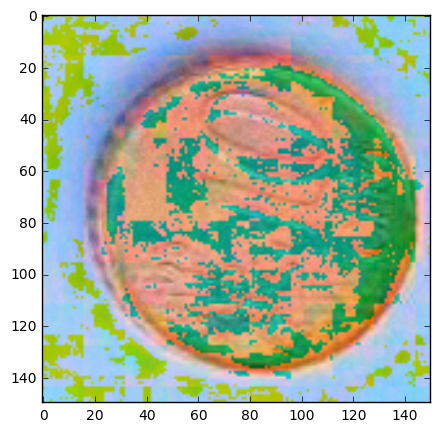

P70210-173031_Candidate_21_150_Brightness_-25.jpg
This is 20 cent
(150, 150, 3)


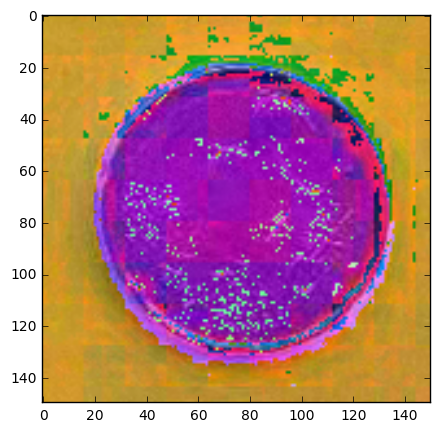

P70210-173155_Candidate_12_150_Brightness_25.jpg
This is 20 cent
(150, 150, 3)


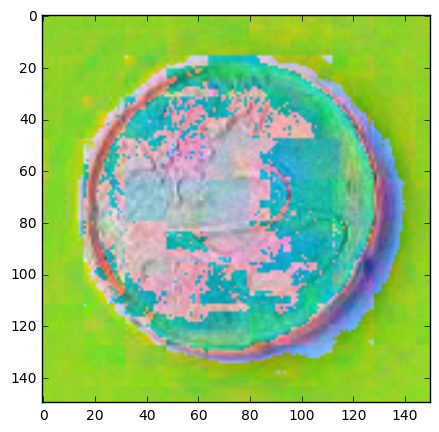

P70210-170305_Candidate_9_150_Brightness_25.jpg
This is 50 cent
(150, 150, 3)


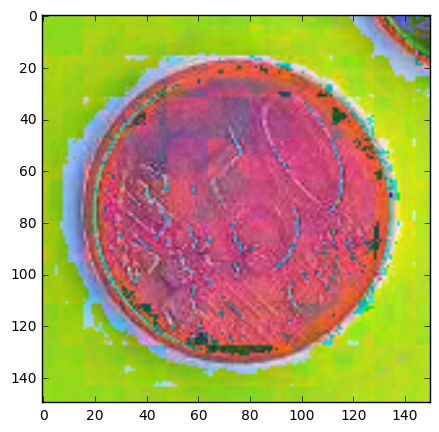

P70210-173253_Candidate_14_150_Brightness_-25.jpg
This is 20 cent
(150, 150, 3)


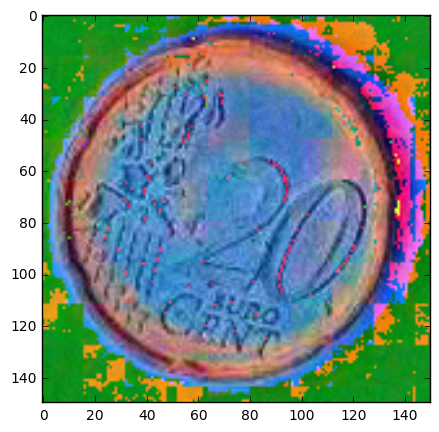

P70210-170048_Candidate_20_150_Brightness_0.jpg
This is 50 cent
(150, 150, 3)


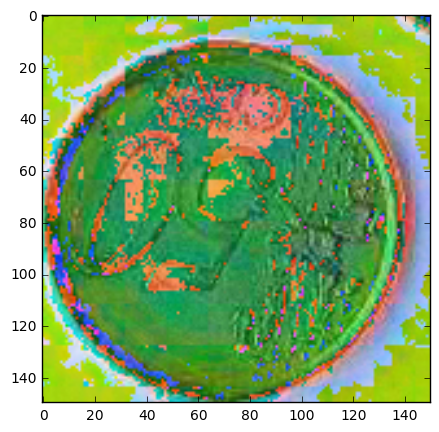

P70210-170459_Candidate_19_150_Brightness_0.jpg
This is 50 cent
(150, 150, 3)


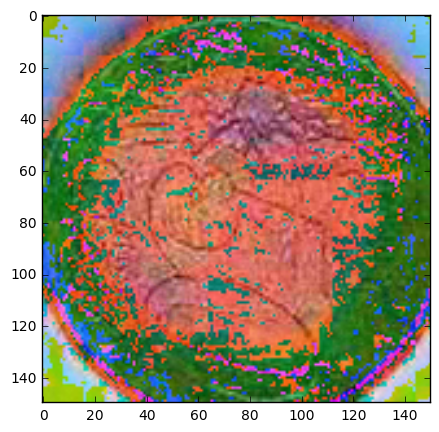

P70210-173115_Candidate_4_150_Brightness_25.jpg
This is 20 cent
(150, 150, 3)


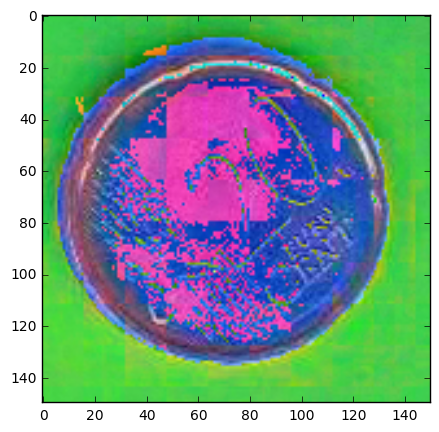

P70216-134828_Candidate_20_150_Brightness_-25.jpg
This is 10 cent
(150, 150, 3)


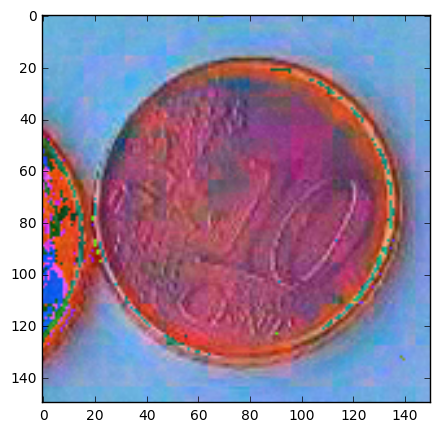

P70210-170638_Candidate_16_150_Brightness_-25.jpg
This is 50 cent
(150, 150, 3)


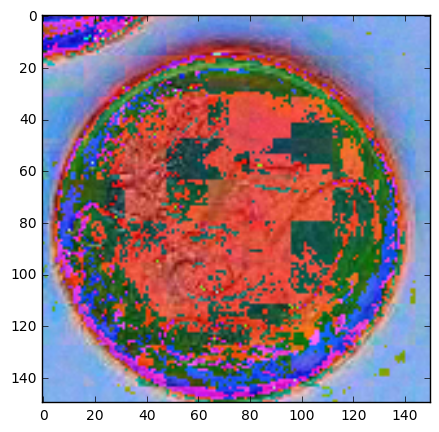

P70216-134545_Candidate_22_150_Brightness_25.jpg
This is 10 cent
(150, 150, 3)


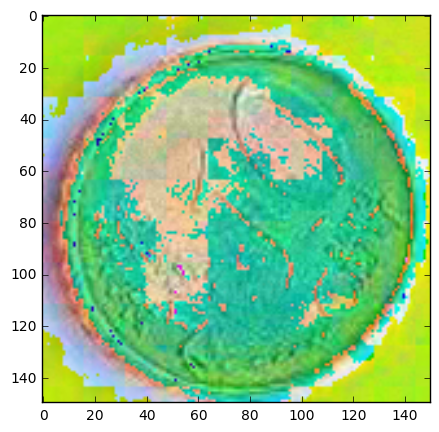

P70216-134413_Candidate_6_150_Brightness_25.jpg
This is 10 cent
(150, 150, 3)


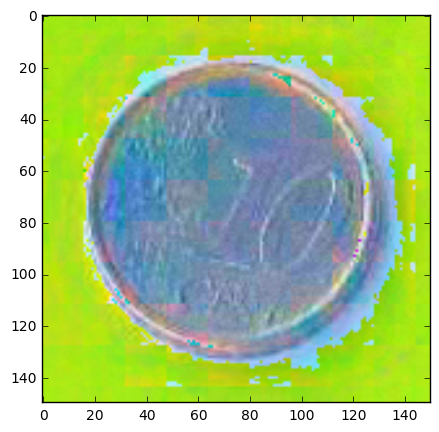

P70210-173403_Candidate_8_150_Brightness_0.jpg
This is 20 cent
(150, 150, 3)


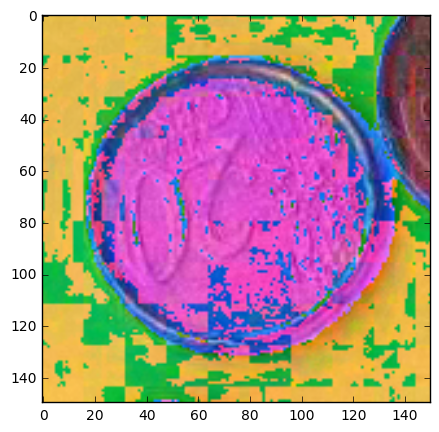

P70216-133928_Candidate_5_150_Brightness_-25.jpg
This is 10 cent
(150, 150, 3)


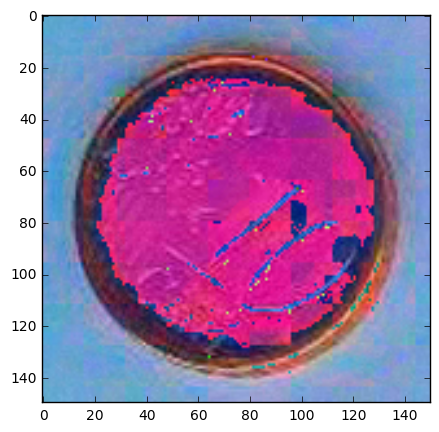

P70216-134243_Candidate_23_150_Brightness_25.jpg
This is 10 cent
(150, 150, 3)


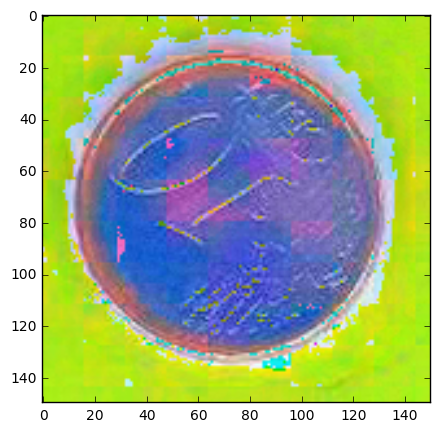

In [4]:
#Print some coins
def printSomeCoints(img, train_images_name, labels, ncoins):
    for i in range(0,ncoins):
        print(train_images_name[i])
        if labels[i] == 0.:
            print("This is 10 cent")
        if labels[i] == 1.:
            print("This is 20 cent")
        if labels[i] == 2.:
            print("This is 50 cent")
        plt.figure(figsize=(10,5))
        print(train[i].shape)
        plt.imshow(cv2.cvtColor(train[i], cv2.COLOR_YUV2RGB))
        plt.show()
    
    
printSomeCoints(train, train_images_name, labels_train_nocategorical, 30)

<html>
<body>
<h2 style = "color:red"> Building the classificator (work in progress..): </h2>
<p> Use the training dataset to build the classificator using a ConvNN.</p>
</body>
</html>

In [5]:
#Loading keras deep learnig libraries to build the model: https://keras.io/ 
from keras.layers import Input, Dense, Flatten, Dropout, Activation, advanced_activations, Convolution2D, MaxPooling2D
from keras.models import Model, model_from_json
from keras.optimizers import RMSprop
from keras.callbacks import ReduceLROnPlateau, EarlyStopping
from keras import initializations

## Standard Architecture

In [7]:
#Model hyperparameters
batch_size = 32 # in each iteration, we consider batch_size training examples at once
num_epochs = 50 # we iterate num_epochs times over the entire training set
kernel_size = 3 # we will use 3x3 kernels throughout
pool_size = 2 # we will use 2x2 pooling throughout
conv_depth_1 = 32 # we will initially have 32 kernels per conv. layer...
conv_depth_2 = 62 # ...switching to 64 after the first pooling layer
conv_depth_3 = 128 # ...switching to 64 after the first pooling layer
conv_depth_4 = 256 # ...switching to 64 after the first pooling layer
conv_depth_5 = 512 # ...switching to 64 after the first pooling layer
drop_prob_1 = 0.25 # dropout after pooling with this probability 
drop_prob_2 = 0.5 # dropout in the FC layer with this probability 
hidden_size = 32 # the FC layer will this neurons
data_augmentation = False # Whether to use or not data augmentation

NN = False
ConvNN = True
if ConvNN == True:
    #Architecture
    inp = Input(shape=(ROWS, COLS, CHANNELS)) # N.B. depth goes first in Keras!
    conv_1 = Convolution2D(conv_depth_1, kernel_size, kernel_size, border_mode='same', activation='relu')(inp)
    pool_1 = MaxPooling2D(pool_size=(pool_size, pool_size))(conv_1)
    conv_2 = Convolution2D(conv_depth_2, kernel_size, kernel_size, border_mode='same', activation='relu')(pool_1)
    pool_2 = MaxPooling2D(pool_size=(pool_size, pool_size))(conv_2)
    conv_3 = Convolution2D(conv_depth_3, kernel_size, kernel_size, border_mode='same', activation='relu')(pool_2)
    pool_3 = MaxPooling2D(pool_size=(pool_size, pool_size))(conv_3)
    conv_4 = Convolution2D(conv_depth_4, kernel_size, kernel_size, border_mode='same', activation='relu')(pool_3)
    pool_4 = MaxPooling2D(pool_size=(pool_size, pool_size))(conv_4)
    conv_5 = Convolution2D(conv_depth_5, kernel_size, kernel_size, border_mode='same', activation='relu')(pool_4)
                       

    flat = Flatten()(conv_5)
    hidden = Dense(hidden_size, activation='sigmoid')(flat)
    out = Dense(nb_classes, activation='sigmoid')(hidden)
    model = Model(input=inp, output=out) # To define a model, just specify its input and output layers

if NN == True:
    #Architecture
    inp = Input(shape=(ROWS, COLS, CHANNELS)) # N.B. depth goes first in Keras!                  
    flat = Flatten()(inp)
    hidden = Dense(hidden_size, activation='tanh')(flat)
    out = Dense(nb_classes, activation='sigmoid')(hidden)
    model = Model(input=inp, output=out) # To define a model, just specify its input and output layers

    
#print the summary of the architecture
model.summary()

#Visulize the model if desired
#from keras.utils.visualize_util import plot
#plot(model, to_file='Example_of_CNN_CatsVsDogs.pdf')

# reduce the learning rate by factor of 0.5 if the validation loss does not get lower in 7 epochs
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=2, min_lr=0.0000001, verbose=1)
early_stopping = EarlyStopping(monitor='val_loss', patience=3, verbose=1, mode='auto')


# Let's train the model using SGD
#model.compile(loss='categorical_crossentropy', optimizer='sgd', metrics=['accuracy'])
#model.compile(loss='categorical_crossentropy', optimizer='adagrad', metrics=['accuracy'])
model.compile(loss='categorical_crossentropy', optimizer=RMSprop(lr=1e-4), metrics=['accuracy'])

# Let's train the SGD model WITHOUT using data augmentation
if not data_augmentation:
    print('Not using data augmentation.')
    history = model.fit(train, labels_train, batch_size=batch_size, nb_epoch=num_epochs, validation_data=(validation, labels_validation), shuffle=True, callbacks=[reduce_lr,early_stopping])
    


____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
input_2 (InputLayer)             (None, 150, 150, 3)   0                                            
____________________________________________________________________________________________________
convolution2d_6 (Convolution2D)  (None, 150, 150, 32)  896         input_2[0][0]                    
____________________________________________________________________________________________________
maxpooling2d_5 (MaxPooling2D)    (None, 75, 75, 32)    0           convolution2d_6[0][0]            
____________________________________________________________________________________________________
convolution2d_7 (Convolution2D)  (None, 75, 75, 62)    17918       maxpooling2d_5[0][0]             
___________________________________________________________________________________________

## Reduced (And deeper) architecture

In [ ]:
#Model hyperparameters
batch_size = 32 # in each iteration, we consider batch_size training examples at once
num_epochs = 50 # we iterate num_epochs times over the entire training set
kernel_size = 3 # we will use 3x3 kernels throughout
pool_size = 2 # we will use 2x2 pooling throughout
conv_depth_1 = 32 # we will initially have 32 kernels per conv. layer...
conv_depth_2 = 62 # ...switching to 64 after the first pooling layer
conv_depth_3 = 128 # ...switching to 64 after the first pooling layer
conv_depth_4 = 256 # ...switching to 64 after the first pooling layer
conv_depth_5 = 512 # ...switching to 64 after the first pooling layer
conv_depth_6 = 1024 # ...switching to 64 after the first pooling layer
conv_depth_7 = 2048 # ...switching to 64 after the first pooling layer
drop_prob_1 = 0.25 # dropout after pooling with this probability 
drop_prob_2 = 0.5 # dropout in the FC layer with this probability 
hidden_size = 16 # the FC layer will this neurons
data_augmentation = False # Whether to use or not data augmentation

NN = False
ConvNN = True
if ConvNN == True:
    #Architecture
    inp = Input(shape=(ROWS, COLS, CHANNELS)) # N.B. depth goes first in Keras!
    conv_1 = Convolution2D(conv_depth_1, kernel_size, kernel_size, border_mode='same', activation='tanh')(inp)
    pool_1 = MaxPooling2D(pool_size=(pool_size, pool_size))(conv_1)
    conv_2 = Convolution2D(conv_depth_2, kernel_size, kernel_size, border_mode='same', activation='tanh')(pool_1)
    pool_2 = MaxPooling2D(pool_size=(pool_size, pool_size))(conv_2)
    conv_3 = Convolution2D(conv_depth_3, kernel_size, kernel_size, border_mode='same', activation='tanh')(pool_2)
    pool_3 = MaxPooling2D(pool_size=(pool_size, pool_size))(conv_3)
    conv_4 = Convolution2D(conv_depth_4, kernel_size, kernel_size, border_mode='same', activation='tanh')(pool_3)
    pool_4 = MaxPooling2D(pool_size=(pool_size, pool_size))(conv_4)
    conv_5 = Convolution2D(conv_depth_5, kernel_size, kernel_size, border_mode='same', activation='tanh')(pool_4)
    pool_5 = MaxPooling2D(pool_size=(pool_size, pool_size))(conv_5)
    conv_6 = Convolution2D(conv_depth_6, kernel_size, kernel_size, border_mode='same', activation='tanh')(pool_5)
                       

    flat = Flatten()(conv_6)
    hidden = Dense(hidden_size, activation='tanh')(flat)
    out = Dense(nb_classes, activation='sigmoid')(hidden)
    model = Model(input=inp, output=out) # To define a model, just specify its input and output layers

if NN == True:
    #Architecture
    inp = Input(shape=(ROWS, COLS, CHANNELS)) # N.B. depth goes first in Keras!                  
    flat = Flatten()(inp)
    hidden = Dense(hidden_size, activation='tanh')(flat)
    out = Dense(nb_classes, activation='sigmoid')(hidden)
    model = Model(input=inp, output=out) # To define a model, just specify its input and output layers

    
#print the summary of the architecture
model.summary()

#Visulize the model if desired
#from keras.utils.visualize_util import plot
#plot(model, to_file='Example_of_CNN_CatsVsDogs.pdf')

# reduce the learning rate by factor of 0.5 if the validation loss does not get lower in 7 epochs
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=2, min_lr=0.0000001, verbose=1)
early_stopping = EarlyStopping(monitor='val_loss', patience=3, verbose=1, mode='auto')


# Let's train the model using SGD
#model.compile(loss='categorical_crossentropy', optimizer='sgd', metrics=['accuracy'])
#model.compile(loss='categorical_crossentropy', optimizer='adagrad', metrics=['accuracy'])
model.compile(loss='categorical_crossentropy', optimizer=RMSprop(lr=1e-4), metrics=['accuracy'])

# Let's train the SGD model WITHOUT using data augmentation
if not data_augmentation:
    print('Not using data augmentation.')
    history = model.fit(train, labels_train, batch_size=batch_size, nb_epoch=num_epochs, validation_data=(validation, labels_validation), shuffle=True, callbacks=[reduce_lr,early_stopping])
                            
                       

# Learning curves (check the performance)

dict_keys(['lr', 'acc', 'val_acc', 'val_loss', 'loss'])


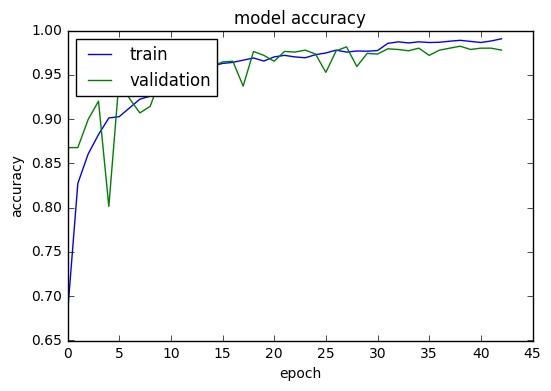

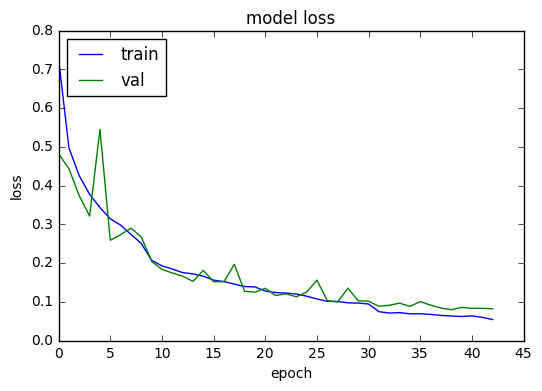

In [8]:
# list all data in history
print(history.history.keys())

# summarize history for accuracy
plt.plot(history.history['acc'])
plt.plot(history.history['val_acc'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()
plt.savefig('Accuracy_Example_Coin_Classifier_GoldenCoins.pdf')
plt.close()


# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()
plt.savefig('Loss_Example_Coin_Classifier_GoldenCoins.pdf')
plt.close()

# Save 

In [9]:
#SaveModel(model, "Model_Example_Coin_Classifier_GoldenCoins_Standard_yuv") #For the standard architecture
#SaveModel(model, "Model_Example_Coin_Classifier_GoldenCoins_Reduced_yuv") #For the reduced architecture
SaveModel(model, "Model_Example_Coin_Classifier_GoldenCoins_150_norm_relu_yuv") #For the reduced deeper architecture

Saved model Model_Example_Coin_Classifier_GoldenCoins_150_norm_relu_yuv to disk


0

# Load and Test model

Loaded model Model_Example_Coin_Classifier_GoldenCoins_150_norm_relu_yuv from disk 

PREDICTIONS 

 0.00745873 of 10 cents 

 0.00844197 of 20 cents 

 0.53980446 of 50 cents 



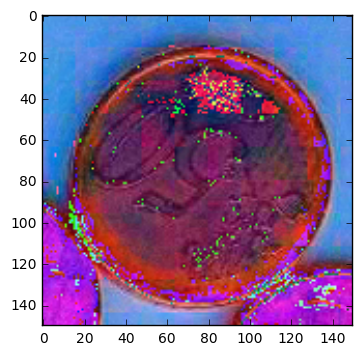

 0.00047442 of 10 cents 

 0.07812389 of 20 cents 

 0.18450230 of 50 cents 



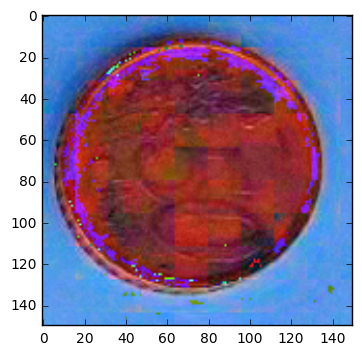

 0.64374232 of 10 cents 

 0.00733600 of 20 cents 

 0.01547318 of 50 cents 



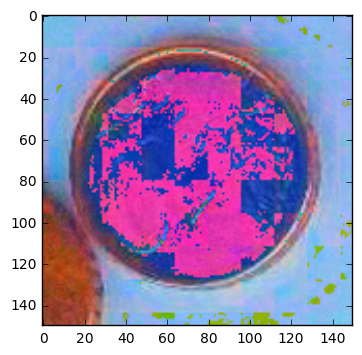

 0.64372641 of 10 cents 

 0.00733599 of 20 cents 

 0.01547391 of 50 cents 



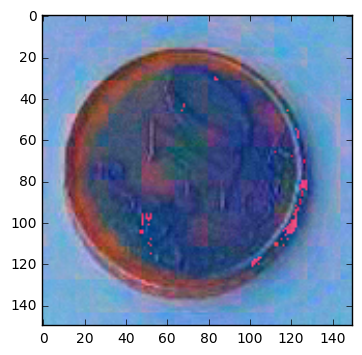

 0.00238239 of 10 cents 

 0.56675988 of 20 cents 

 0.00570907 of 50 cents 



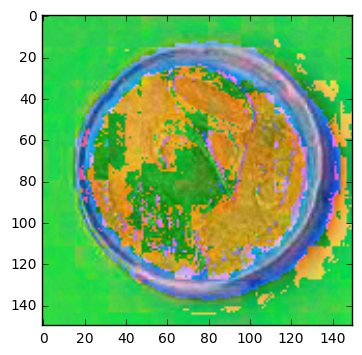

 0.64372104 of 10 cents 

 0.00733649 of 20 cents 

 0.01547222 of 50 cents 



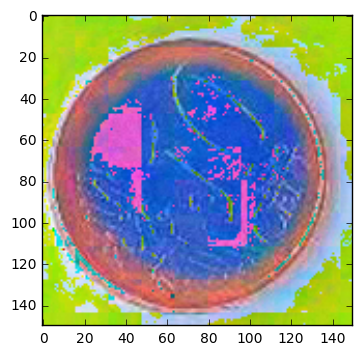

 0.00225223 of 10 cents 

 0.58157963 of 20 cents 

 0.00614704 of 50 cents 



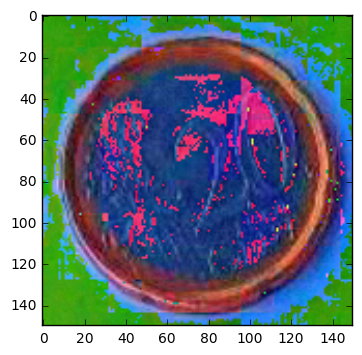

 0.00116037 of 10 cents 

 0.04043935 of 20 cents 

 0.22163524 of 50 cents 



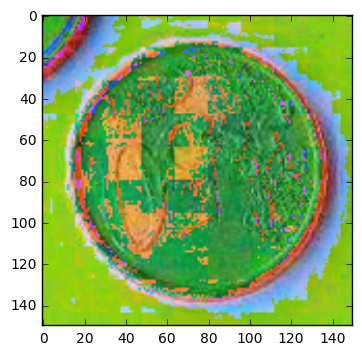

 0.64367270 of 10 cents 

 0.00733760 of 20 cents 

 0.01547160 of 50 cents 



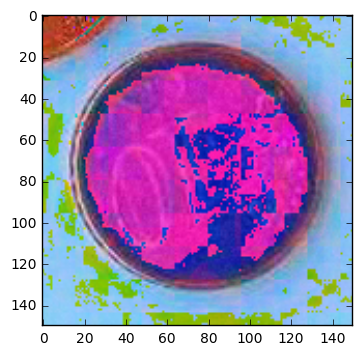

 0.00205754 of 10 cents 

 0.60510802 of 20 cents 

 0.00692185 of 50 cents 



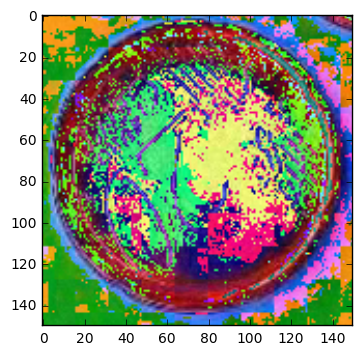

 0.00238239 of 10 cents 

 0.56675988 of 20 cents 

 0.00570907 of 50 cents 



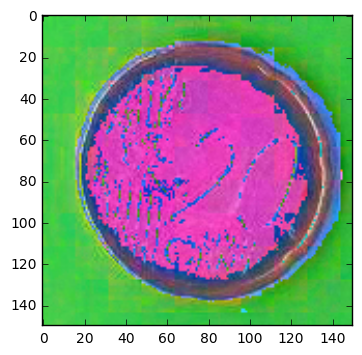

 0.00378902 of 10 cents 

 0.01528222 of 20 cents 

 0.52901000 of 50 cents 



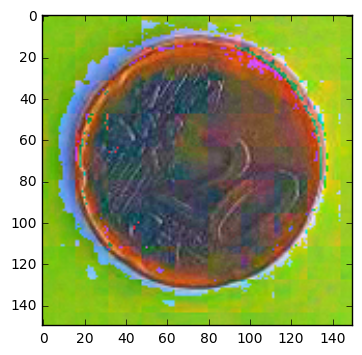

 0.00744061 of 10 cents 

 0.00836391 of 20 cents 

 0.54236305 of 50 cents 



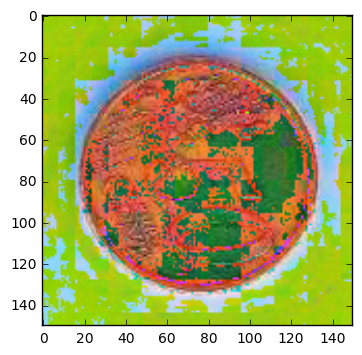

 0.00238239 of 10 cents 

 0.56675988 of 20 cents 

 0.00570907 of 50 cents 



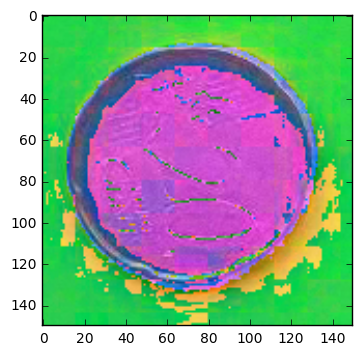

 0.00741166 of 10 cents 

 0.00839037 of 20 cents 

 0.54103744 of 50 cents 



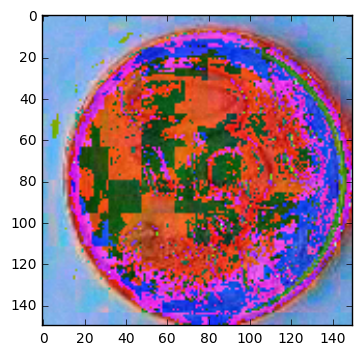

 0.00744657 of 10 cents 

 0.00836281 of 20 cents 

 0.54241961 of 50 cents 



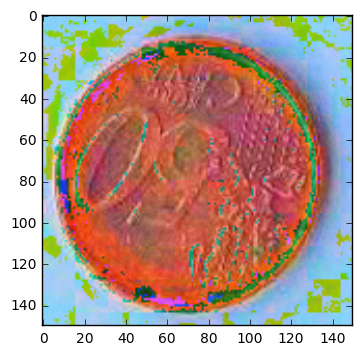

 0.00261441 of 10 cents 

 0.52030259 of 20 cents 

 0.00930447 of 50 cents 



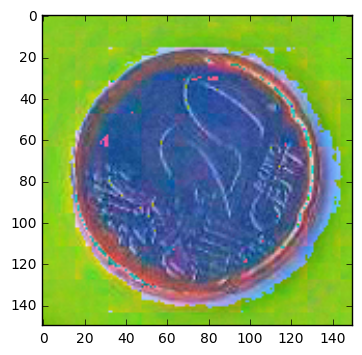

 0.00739193 of 10 cents 

 0.00840860 of 20 cents 

 0.54203802 of 50 cents 



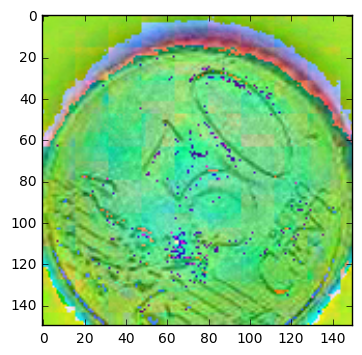

 0.00238239 of 10 cents 

 0.56675988 of 20 cents 

 0.00570907 of 50 cents 



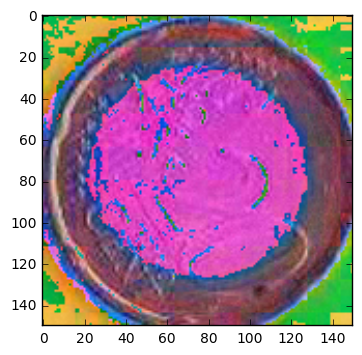

 0.00023153 of 10 cents 

 0.22515319 of 20 cents 

 0.11572758 of 50 cents 



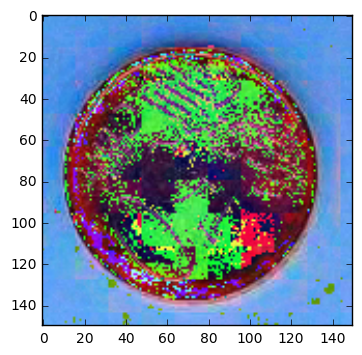

 0.64334387 of 10 cents 

 0.00732177 of 20 cents 

 0.01551337 of 50 cents 



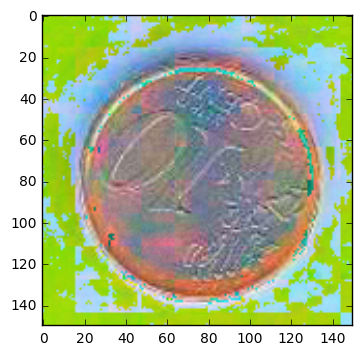

 0.63997108 of 10 cents 

 0.00733060 of 20 cents 

 0.01560966 of 50 cents 



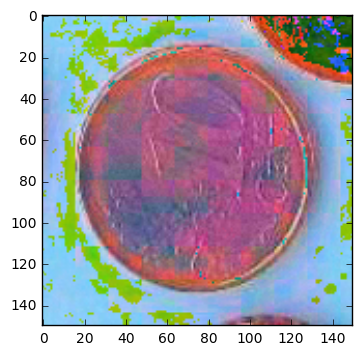

 0.64374167 of 10 cents 

 0.00733597 of 20 cents 

 0.01547326 of 50 cents 



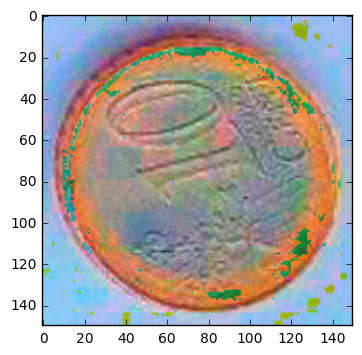

 0.00142658 of 10 cents 

 0.06807359 of 20 cents 

 0.20903714 of 50 cents 



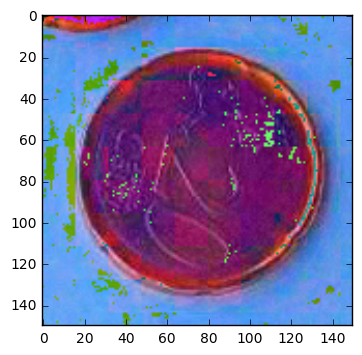

 0.64088440 of 10 cents 

 0.00648530 of 20 cents 

 0.01912735 of 50 cents 



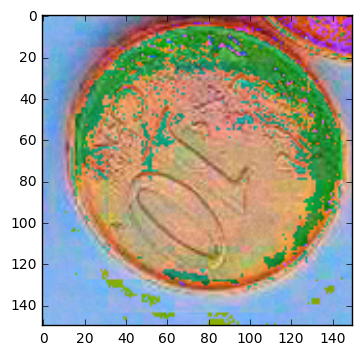

 0.64372927 of 10 cents 

 0.00733565 of 20 cents 

 0.01547441 of 50 cents 



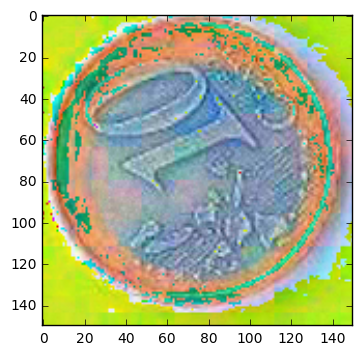

 0.64333212 of 10 cents 

 0.00732052 of 20 cents 

 0.01552280 of 50 cents 



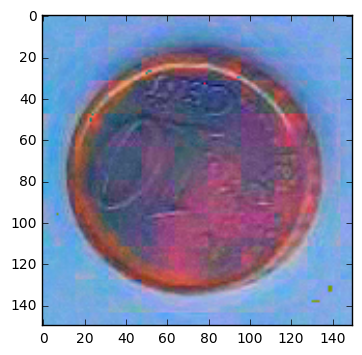

 0.00287049 of 10 cents 

 0.01858458 of 20 cents 

 0.44486114 of 50 cents 



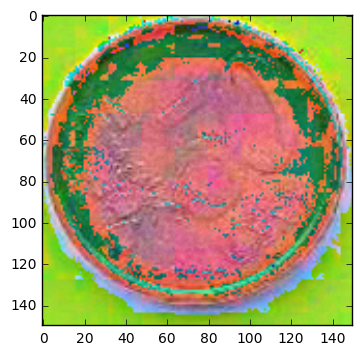

 0.00238239 of 10 cents 

 0.56675988 of 20 cents 

 0.00570907 of 50 cents 



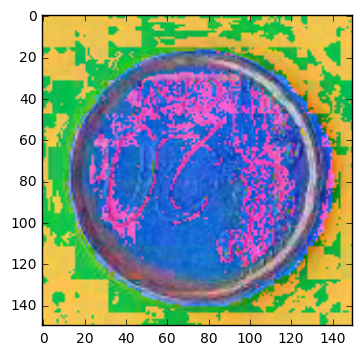

 0.00696307 of 10 cents 

 0.00944048 of 20 cents 

 0.51901633 of 50 cents 



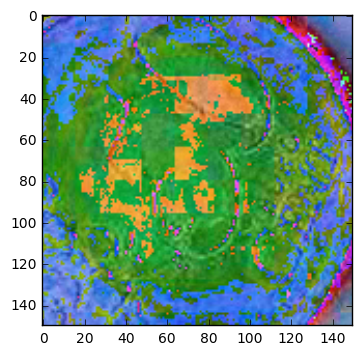

 0.02131450 of 10 cents 

 0.00509764 of 20 cents 

 0.52278811 of 50 cents 



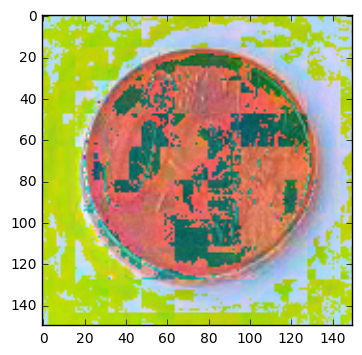

 0.00748010 of 10 cents 

 0.00834281 of 20 cents 

 0.54273611 of 50 cents 



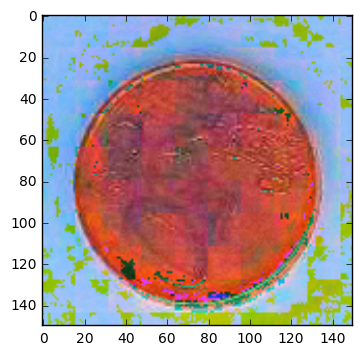

 0.00083768 of 10 cents 

 0.54991996 of 20 cents 

 0.02052455 of 50 cents 



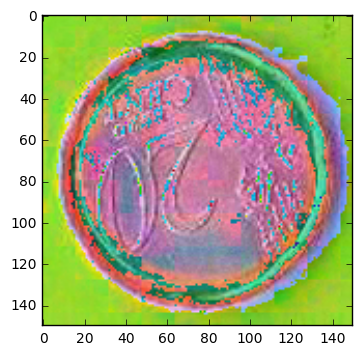

 0.64325798 of 10 cents 

 0.00733479 of 20 cents 

 0.01549193 of 50 cents 



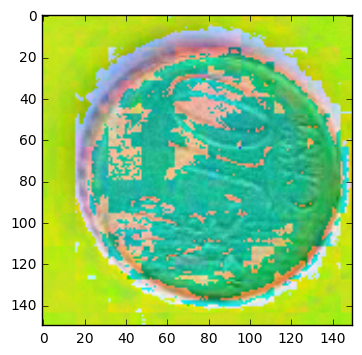

 0.00920766 of 10 cents 

 0.00796555 of 20 cents 

 0.53337848 of 50 cents 



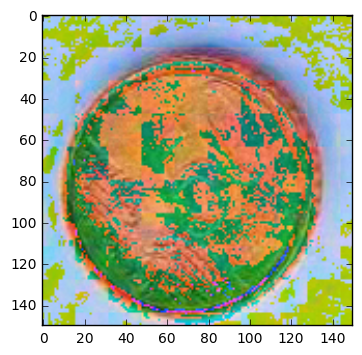

 0.00757115 of 10 cents 

 0.00842945 of 20 cents 

 0.53857243 of 50 cents 



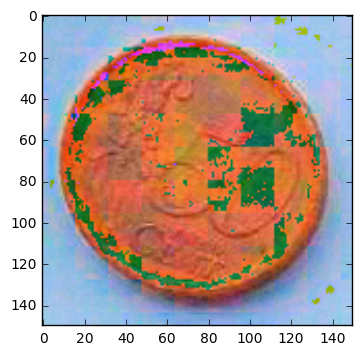

 0.00595619 of 10 cents 

 0.01361954 of 20 cents 

 0.44997382 of 50 cents 



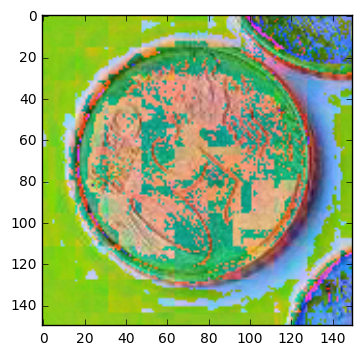

 0.64230514 of 10 cents 

 0.00737259 of 20 cents 

 0.01546312 of 50 cents 



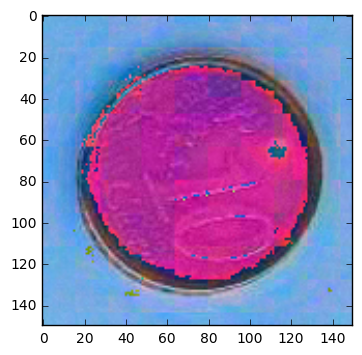

 0.00778921 of 10 cents 

 0.01455456 of 20 cents 

 0.35503957 of 50 cents 



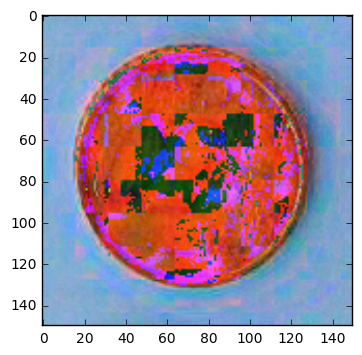

 0.62170583 of 10 cents 

 0.00542917 of 20 cents 

 0.02519006 of 50 cents 



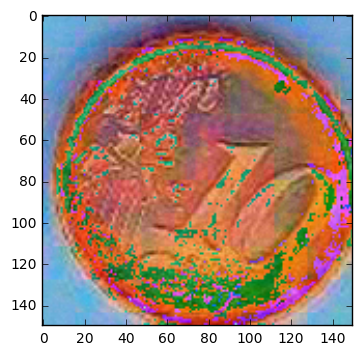

 0.00016911 of 10 cents 

 0.30476007 of 20 cents 

 0.08723169 of 50 cents 



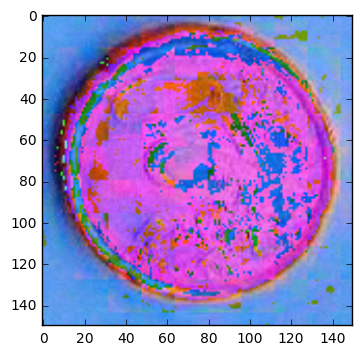

 0.00238239 of 10 cents 

 0.56675988 of 20 cents 

 0.00570906 of 50 cents 



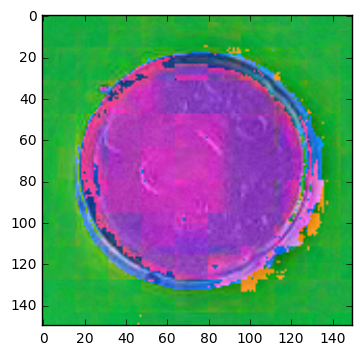

 0.00727512 of 10 cents 

 0.01103839 of 20 cents 

 0.44259149 of 50 cents 



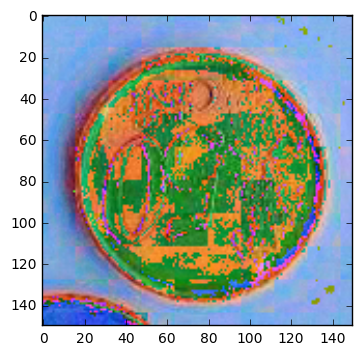

 0.64367133 of 10 cents 

 0.00733586 of 20 cents 

 0.01547522 of 50 cents 



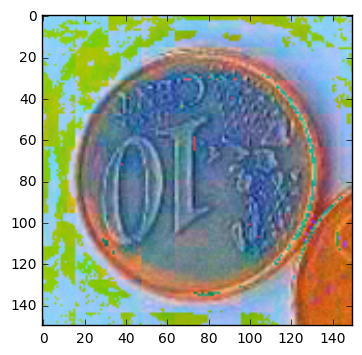

 0.00513031 of 10 cents 

 0.01123891 of 20 cents 

 0.52284539 of 50 cents 



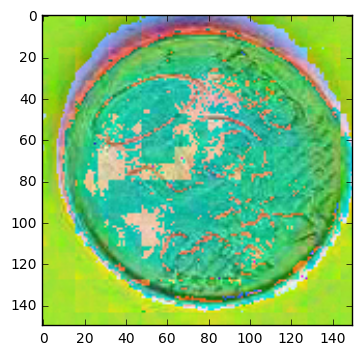

In [11]:
#Useful to test.
LoadAndTest = True
nTest = 45
if LoadAndTest == True:
    #loaded_model=LoadModel("Model_Example_Coin_Classifier_GoldenCoins_Standard_yuv") #For the standard architecture
    #loaded_model=LoadModel("Model_Example_Coin_Classifier_GoldenCoins_Reduced_yuv") #For the reduced architecture
    loaded_model=LoadModel("Model_Example_Coin_Classifier_GoldenCoins_150_norm_relu_yuv") #For the reduced deeper architecture
    # evaluate loaded model on test data
    loaded_model.compile(loss='categorical_crossentropy', optimizer=RMSprop(lr=1e-4), metrics=['accuracy'])
    
    #score_train = loaded_model.evaluate(train, labels_train, verbose=0)
    #score_validation = loaded_model.evaluate(validation, labels_validation, verbose=0)
    #print "Training %s: %.2f%%" % (loaded_model.metrics_names[1], score_train[1]*100)
    #print "Validation %s: %.2f%%" % (loaded_model.metrics_names[1], score_validation[1]*100)    
    
    print("PREDICTIONS \n")
    reduced_test = test[:nTest]
    predictedLabel = loaded_model.predict(reduced_test)

    for i in range(0,nTest):
        print(" %.8f of 10 cents \n" % predictedLabel[i,0])
        print(" %.8f of 20 cents \n" % predictedLabel[i,1])
        print(" %.8f of 50 cents \n" % predictedLabel[i,2])

        plt.imshow(cv2.cvtColor(reduced_test[i], cv2.COLOR_YUV2RGB))
        plt.show()
    
        
    

## Testing with mixed coins images

--- 10 cents ---
--- 10 cents : VALIDATION SET ---
--- 20 cents ---
--- 20 cents : VALIDATION SET ---
--- 50 cents ---
--- 50 cents : VALIDATION SET ---
Loaded model Model_Example_Coin_Classifier_GoldenCoins_150_norm_relu_yuv from disk 

PREDICTIONS 

 0.64371270 of 10 cent 

 0.00733465 of 20 cent 

 0.01547709 of 50 cent 

[[ 0.6437127   0.00733465  0.01547709]]


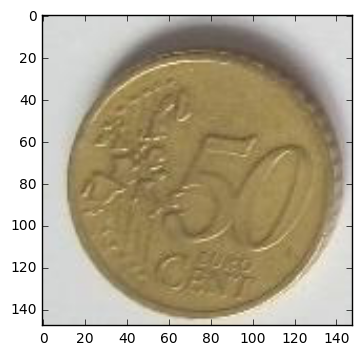

 0.00947772 of 10 cent 

 0.01412293 of 20 cent 

 0.34524065 of 50 cent 

[[ 0.00947772  0.01412293  0.34524065]]


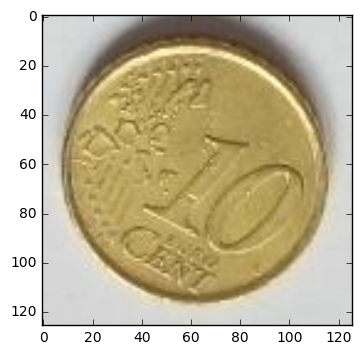

 0.07794818 of 10 cent 

 0.00512277 of 20 cent 

 0.32397911 of 50 cent 

[[ 0.07794818  0.00512277  0.32397911]]


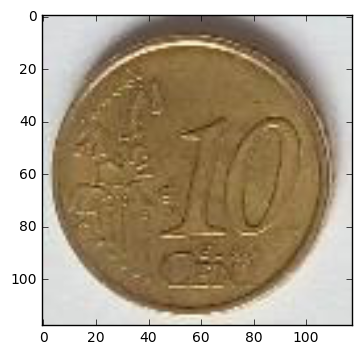

 0.60310537 of 10 cent 

 0.00712800 of 20 cent 

 0.01900925 of 50 cent 

[[ 0.60310537  0.007128    0.01900925]]


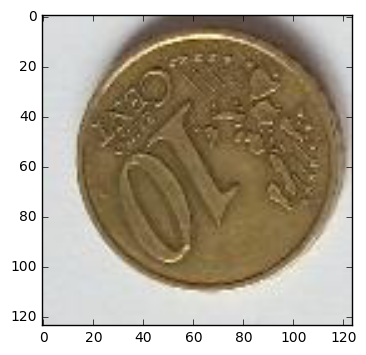

 0.06994008 of 10 cent 

 0.00893806 of 20 cent 

 0.15387195 of 50 cent 

[[ 0.06994008  0.00893806  0.15387195]]


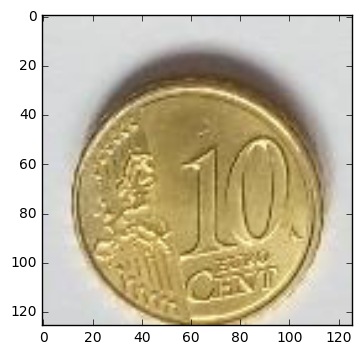

 0.02457197 of 10 cent 

 0.00569403 of 20 cent 

 0.49093488 of 50 cent 

[[ 0.02457197  0.00569403  0.49093488]]


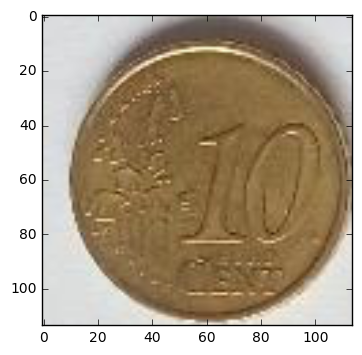

 0.64370382 of 10 cent 

 0.00713565 of 20 cent 

 0.01611426 of 50 cent 

[[ 0.64370382  0.00713565  0.01611426]]


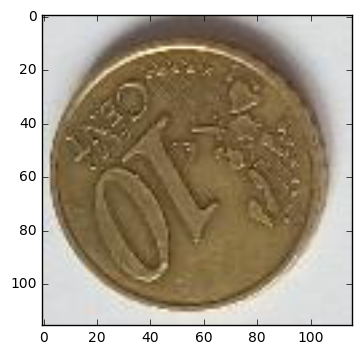

 0.00737600 of 10 cent 

 0.00856008 of 20 cent 

 0.53334701 of 50 cent 

[[ 0.007376    0.00856008  0.53334701]]


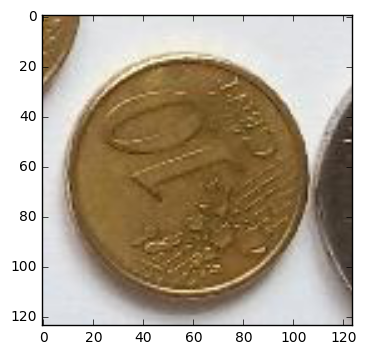

 0.00128635 of 10 cent 

 0.02894627 of 20 cent 

 0.33387738 of 50 cent 

[[ 0.00128635  0.02894627  0.33387738]]


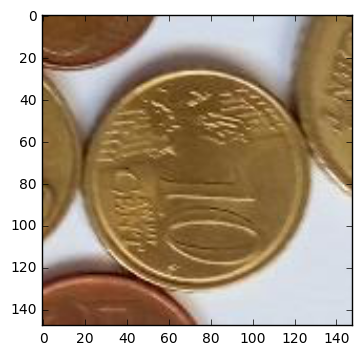

 0.00796123 of 10 cent 

 0.01055662 of 20 cent 

 0.46842143 of 50 cent 

[[ 0.00796123  0.01055662  0.46842143]]


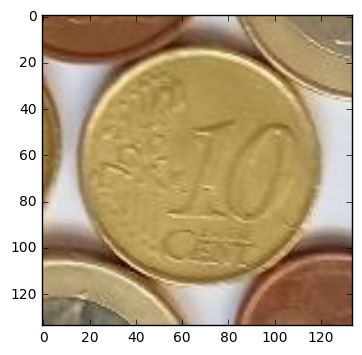

 0.00744368 of 10 cent 

 0.00837305 of 20 cent 

 0.54200864 of 50 cent 

[[ 0.00744368  0.00837305  0.54200864]]


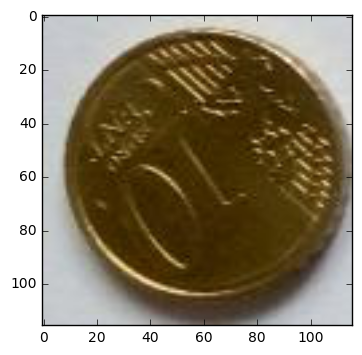

 0.00721796 of 10 cent 

 0.00936780 of 20 cent 

 0.49923900 of 50 cent 

[[ 0.00721796  0.0093678   0.499239  ]]


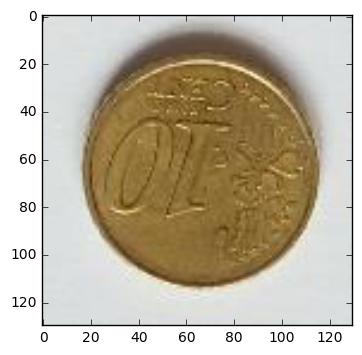

 0.63432252 of 10 cent 

 0.00487899 of 20 cent 

 0.02674697 of 50 cent 

[[ 0.63432252  0.00487899  0.02674697]]


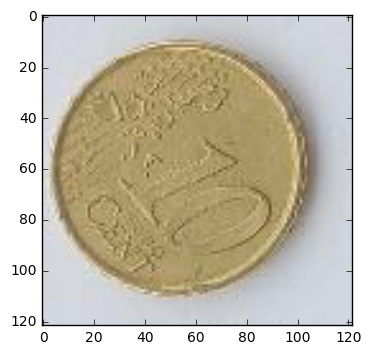

 0.64374018 of 10 cent 

 0.00733599 of 20 cent 

 0.01547327 of 50 cent 

[[ 0.64374018  0.00733599  0.01547327]]


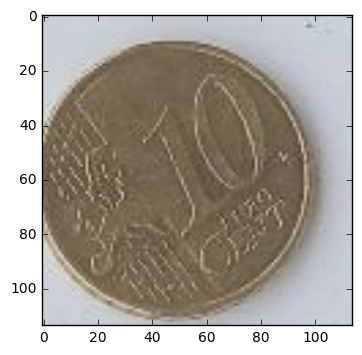

 0.64359659 of 10 cent 

 0.00732547 of 20 cent 

 0.01550502 of 50 cent 

[[ 0.64359659  0.00732547  0.01550502]]


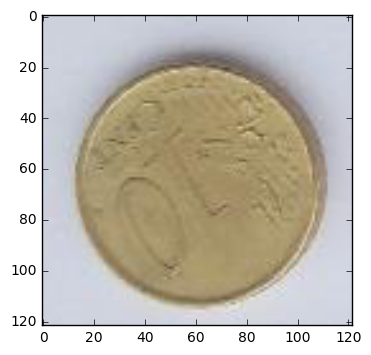

 0.64374036 of 10 cent 

 0.00733585 of 20 cent 

 0.01547348 of 50 cent 

[[ 0.64374036  0.00733585  0.01547348]]


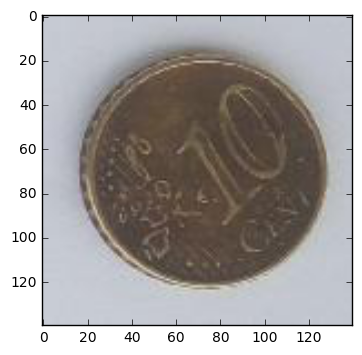

 0.64294386 of 10 cent 

 0.00735702 of 20 cent 

 0.01545848 of 50 cent 

[[ 0.64294386  0.00735702  0.01545848]]


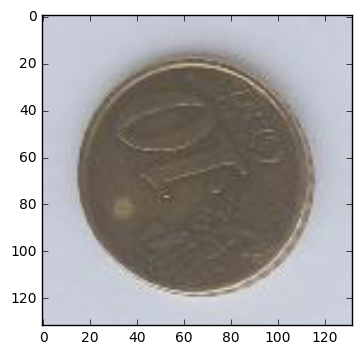

 0.64364809 of 10 cent 

 0.00733507 of 20 cent 

 0.01547871 of 50 cent 

[[ 0.64364809  0.00733507  0.01547871]]


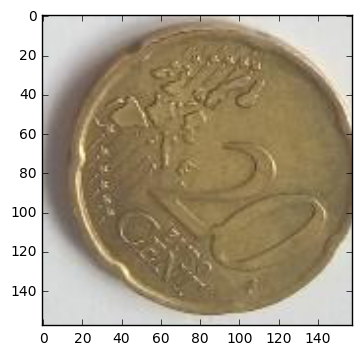

 0.58815873 of 10 cent 

 0.00730823 of 20 cent 

 0.01956192 of 50 cent 

[[ 0.58815873  0.00730823  0.01956192]]


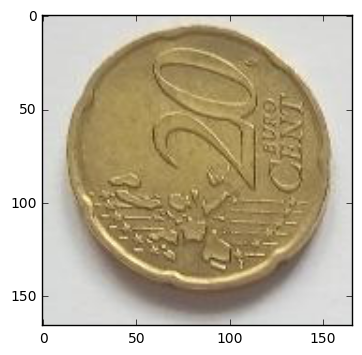

 0.14673322 of 10 cent 

 0.00843452 of 20 cent 

 0.12981284 of 50 cent 

[[ 0.14673322  0.00843452  0.12981284]]


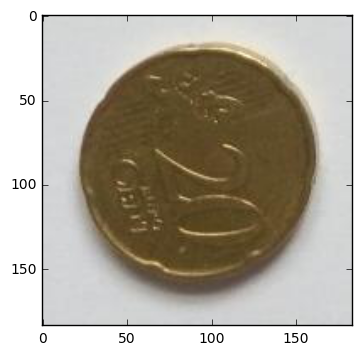

 0.57849139 of 10 cent 

 0.00735768 of 20 cent 

 0.01896724 of 50 cent 

[[ 0.57849139  0.00735768  0.01896724]]


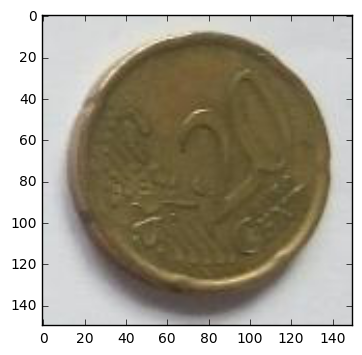

 0.05990999 of 10 cent 

 0.01016814 of 20 cent 

 0.12708090 of 50 cent 

[[ 0.05990999  0.01016814  0.1270809 ]]


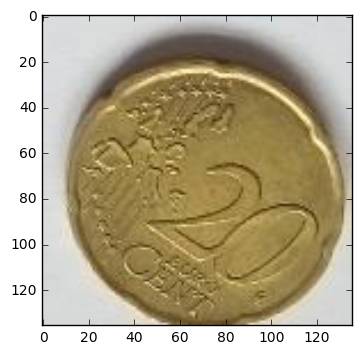

 0.00831217 of 10 cent 

 0.01263697 of 20 cent 

 0.40903941 of 50 cent 

[[ 0.00831217  0.01263697  0.40903941]]


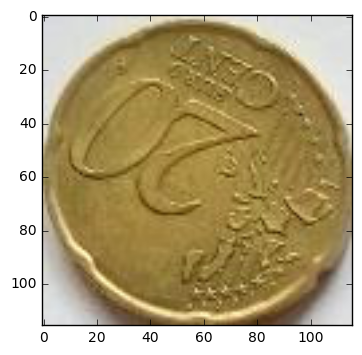

 0.00751139 of 10 cent 

 0.00856189 of 20 cent 

 0.53507280 of 50 cent 

[[ 0.00751139  0.00856189  0.5350728 ]]


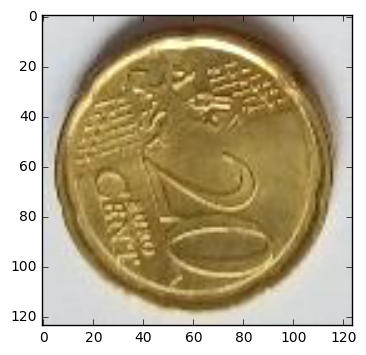

 0.00813822 of 10 cent 

 0.01410119 of 20 cent 

 0.36962512 of 50 cent 

[[ 0.00813822  0.01410119  0.36962512]]


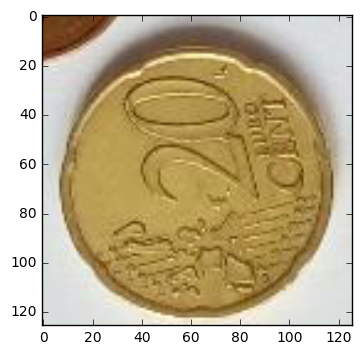

 0.05990999 of 10 cent 

 0.01016814 of 20 cent 

 0.12708090 of 50 cent 

[[ 0.05990999  0.01016814  0.1270809 ]]


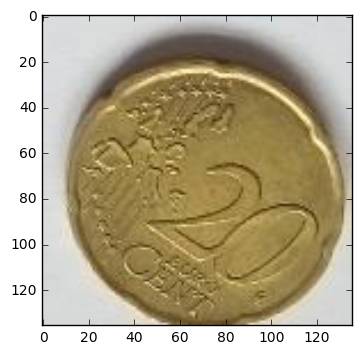

 0.00238239 of 10 cent 

 0.56675953 of 20 cent 

 0.00570907 of 50 cent 

[[ 0.00238239  0.56675953  0.00570907]]


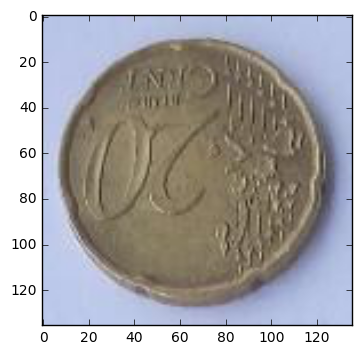

 0.00238244 of 10 cent 

 0.56675464 of 20 cent 

 0.00570911 of 50 cent 

[[ 0.00238244  0.56675464  0.00570911]]


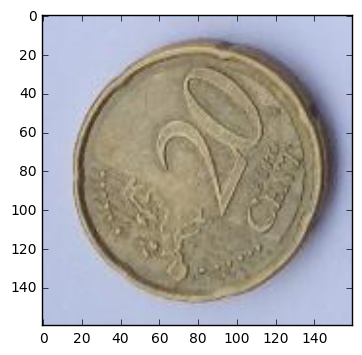

 0.00238275 of 10 cent 

 0.56672376 of 20 cent 

 0.00570943 of 50 cent 

[[ 0.00238275  0.56672376  0.00570943]]


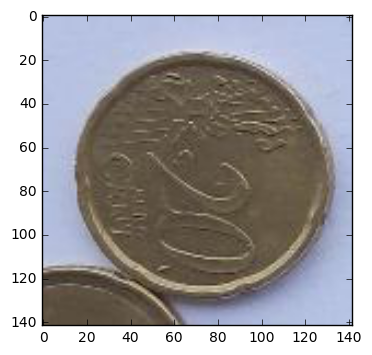

 0.00238239 of 10 cent 

 0.56675982 of 20 cent 

 0.00570907 of 50 cent 

[[ 0.00238239  0.56675982  0.00570907]]


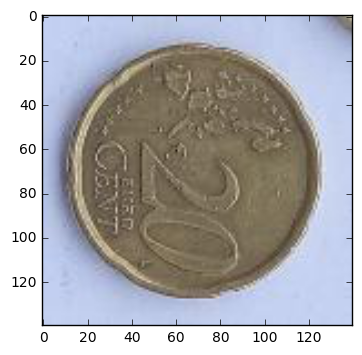

 0.00238239 of 10 cent 

 0.56675988 of 20 cent 

 0.00570907 of 50 cent 

[[ 0.00238239  0.56675988  0.00570907]]


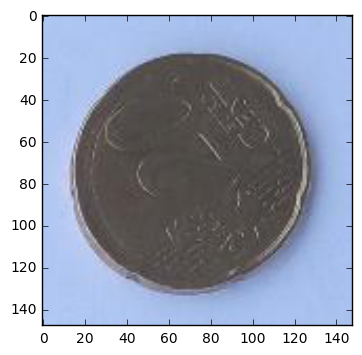

 0.53326106 of 10 cent 

 0.00597560 of 20 cent 

 0.02957782 of 50 cent 

[[ 0.53326106  0.0059756   0.02957782]]


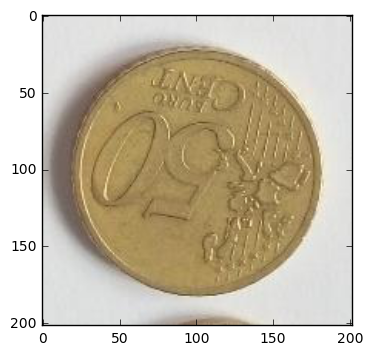

 0.64168340 of 10 cent 

 0.00689312 of 20 cent 

 0.01712907 of 50 cent 

[[ 0.6416834   0.00689312  0.01712907]]


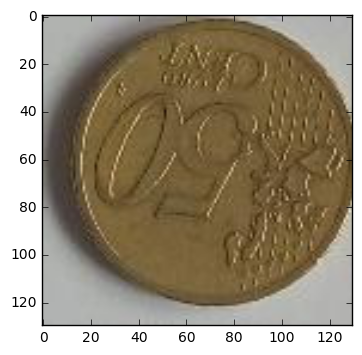

 0.64484560 of 10 cent 

 0.00702254 of 20 cent 

 0.01651828 of 50 cent 

[[ 0.6448456   0.00702254  0.01651828]]


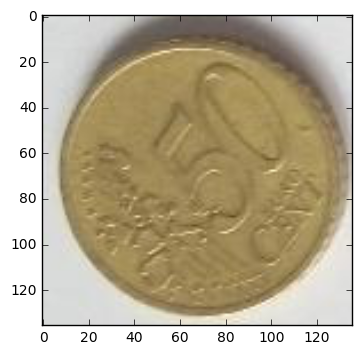

 0.64371270 of 10 cent 

 0.00733465 of 20 cent 

 0.01547709 of 50 cent 

[[ 0.6437127   0.00733465  0.01547709]]


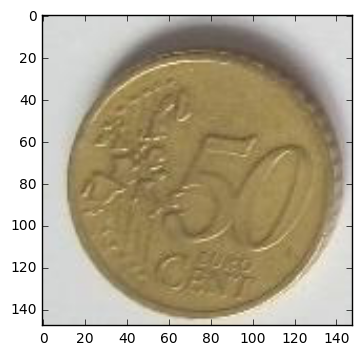

 0.34400970 of 10 cent 

 0.00486866 of 20 cent 

 0.10586419 of 50 cent 

[[ 0.3440097   0.00486866  0.10586419]]


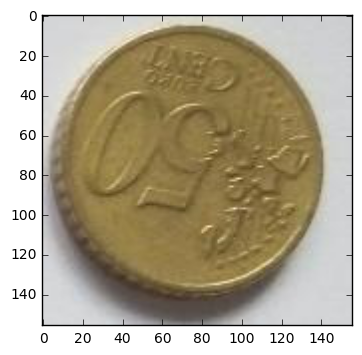

 0.00743052 of 10 cent 

 0.00857017 of 20 cent 

 0.53371787 of 50 cent 

[[ 0.00743052  0.00857017  0.53371787]]


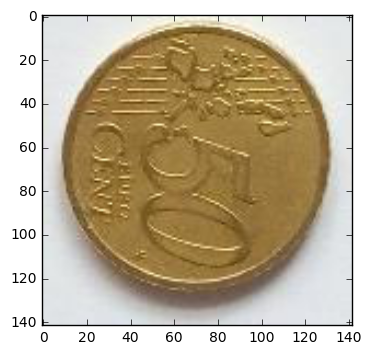

 0.00794770 of 10 cent 

 0.01035034 of 20 cent 

 0.47372070 of 50 cent 

[[ 0.0079477   0.01035034  0.4737207 ]]


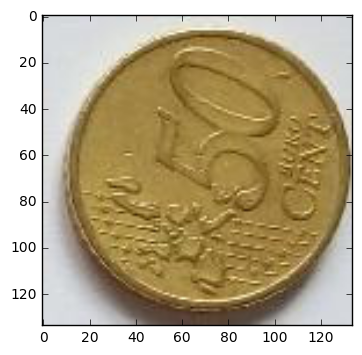

 0.00744436 of 10 cent 

 0.00836856 of 20 cent 

 0.54224104 of 50 cent 

[[ 0.00744436  0.00836856  0.54224104]]


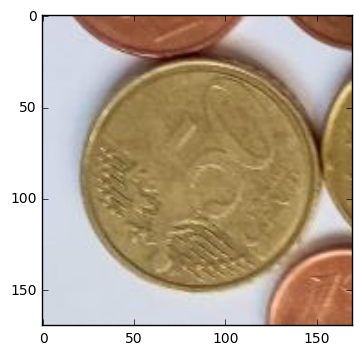

 0.00092671 of 10 cent 

 0.05120736 of 20 cent 

 0.17432483 of 50 cent 

[[ 0.00092671  0.05120736  0.17432483]]


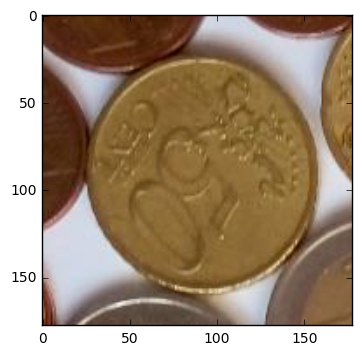

 0.00754958 of 10 cent 

 0.00832581 of 20 cent 

 0.53876507 of 50 cent 

[[ 0.00754958  0.00832581  0.53876507]]


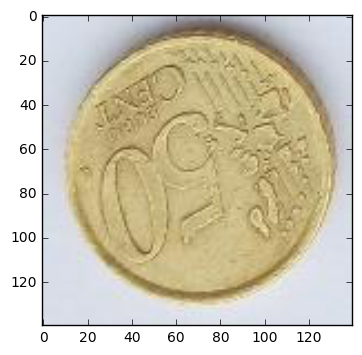

 0.00740139 of 10 cent 

 0.00841951 of 20 cent 

 0.54090995 of 50 cent 

[[ 0.00740139  0.00841951  0.54090995]]


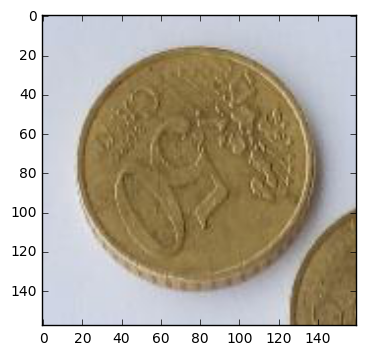

 0.00743235 of 10 cent 

 0.00838659 of 20 cent 

 0.54133642 of 50 cent 

[[ 0.00743235  0.00838659  0.54133642]]


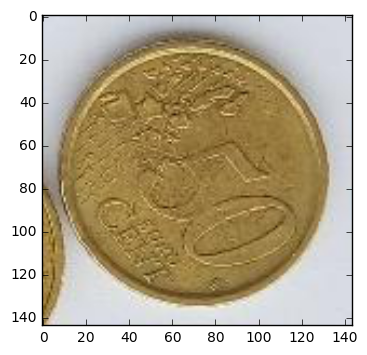

 0.00744674 of 10 cent 

 0.00836115 of 20 cent 

 0.54249734 of 50 cent 

[[ 0.00744674  0.00836115  0.54249734]]


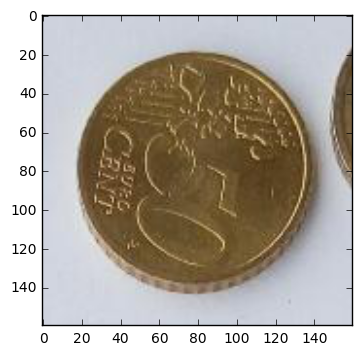

 0.00399120 of 10 cent 

 0.01442705 of 20 cent 

 0.49357191 of 50 cent 

[[ 0.0039912   0.01442705  0.49357191]]


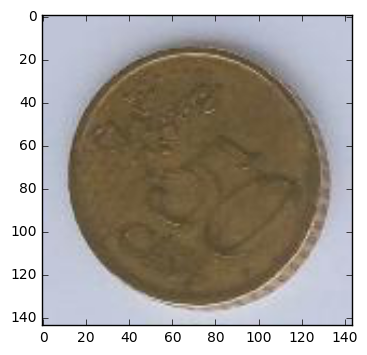

In [13]:
#Useful to test.
TEST_DIR = 'CandidateDataSet2/Processed_RAW/mix/'
#input_file = glob.glob(TEST_DIR+"*.jpg") #Try new Samples
input_file = [TEST_DIR+"P70216-160609_Candidate_6.jpg"]  #For debugging
print("--- 10 cents ---")
input_file.append(TEST_DIR+"P70216-160642_Candidate_10.jpg")
input_file.append(TEST_DIR+"P70216-160642_Candidate_20.jpg")
input_file.append(TEST_DIR+"P70216-160642_Candidate_21.jpg")
input_file.append(TEST_DIR+"P70216-160652_Candidate_27.jpg")
input_file.append(TEST_DIR+"P70216-160652_Candidate_25.jpg")
input_file.append(TEST_DIR+"P70216-160652_Candidate_26.jpg")
input_file.append(TEST_DIR+"P70216-160813_Candidate_37.jpg")
input_file.append(TEST_DIR+"P70216-161849_Candidate_4.jpg")
input_file.append(TEST_DIR+"P70216-161849_Candidate_18.jpg")
input_file.append(TEST_DIR+"P70216-161000_Candidate_34.jpg")
input_file.append(TEST_DIR+"P70216-160854_Candidate_38.jpg")
print("--- 10 cents : VALIDATION SET ---")
VAL_DIR = 'CandidateDataSet2/Processed_RAW/10cent/'
input_file.append(VAL_DIR+"P70216-134319_Candidate_14.jpg")
input_file.append(VAL_DIR+"P70216-134504_Candidate_21.jpg")
input_file.append(VAL_DIR+"P70216-134748_Candidate_5.jpg")
input_file.append(VAL_DIR+"P70216-134440_Candidate_9.jpg")
input_file.append(VAL_DIR+"P70216-134748_Candidate_9.jpg")
print("--- 20 cents ---")
input_file.append(TEST_DIR+"P70216-160459_Candidate_5.jpg")
input_file.append(TEST_DIR+"P70216-160524_Candidate_2.jpg")
input_file.append(TEST_DIR+"P70216-160630_Candidate_9.jpg")
input_file.append(TEST_DIR+"P70216-160630_Candidate_17.jpg")
input_file.append(TEST_DIR+"P70216-160652_Candidate_7.jpg")
input_file.append(TEST_DIR+"P70216-160813_Candidate_8.jpg")
input_file.append(TEST_DIR+"P70216-160854_Candidate_7.jpg")
input_file.append(TEST_DIR+"P70216-160854_Candidate_29.jpg")
input_file.append(TEST_DIR+"P70216-160652_Candidate_7.jpg")
print("--- 20 cents : VALIDATION SET ---")
VAL_DIR = 'CandidateDataSet2/Processed_RAW/20cent/'
input_file.append(VAL_DIR+"P70210-172818_Candidate_14.jpg")
input_file.append(VAL_DIR+"P70210-172835_Candidate_1.jpg")
input_file.append(VAL_DIR+"P70210-173008_Candidate_3.jpg")
input_file.append(VAL_DIR+"P70210-173043_Candidate_15.jpg")
input_file.append(VAL_DIR+"P70210-173134_Candidate_13.jpg")
print("--- 50 cents ---")
input_file.append(TEST_DIR+"P70216-160459_Candidate_6.jpg")
input_file.append(TEST_DIR+"P70216-160434_Candidate_5.jpg")
input_file.append(TEST_DIR+"P70216-160549_Candidate_5.jpg")
input_file.append(TEST_DIR+"P70216-160609_Candidate_6.jpg")
input_file.append(TEST_DIR+"P70216-160630_Candidate_13.jpg")
input_file.append(TEST_DIR+"P70216-160813_Candidate_24.jpg")
input_file.append(TEST_DIR+"P70216-161000_Candidate_26.jpg")
input_file.append(TEST_DIR+"P70216-161849_Candidate_13.jpg")
input_file.append(TEST_DIR+"P70216-161845_Candidate_10.jpg")
print("--- 50 cents : VALIDATION SET ---")
VAL_DIR = 'CandidateDataSet2/Processed_RAW/50cent/'
input_file.append(VAL_DIR+"P70210-165438_Candidate_20.jpg")
input_file.append(VAL_DIR+"P70210-165500_Candidate_7.jpg")
input_file.append(VAL_DIR+"P70210-165718_Candidate_4.jpg")
input_file.append(VAL_DIR+"P70210-165812_Candidate_3.jpg")
input_file.append(VAL_DIR+"P70210-165858_Candidate_4.jpg")
LoadAndTest = True
if LoadAndTest == True:
    #loaded_model=LoadModel("Model_Example_Coin_Classifier_GoldenCoins_Standard_yuv") #For the standard architecture
    loaded_model=LoadModel("Model_Example_Coin_Classifier_GoldenCoins_150_norm_relu_yuv") #For the reduced architecture
    # evaluate loaded model on test data
    #loaded_model.compile(loss='categorical_crossentropy', optimizer=RMSprop(lr=1e-4), metrics=['accuracy'])
    print("PREDICTIONS \n")
    for kfile in input_file:
        im = Image.open(kfile)
        imarray = np.array(im)
        imgResizedTest = cv2.resize(imarray, (ROWS, COLS), interpolation=cv2.INTER_CUBIC)
        imgResizedTest = cv2.cvtColor(imgResizedTest, cv2.COLOR_RGB2YUV)
        #imy,imu,imv = cv2.split(imgResizedTest)
        #imy = demean(imy)
        #imy = demean(imy,axis=1)
        #imu = demean(imu)
        #imu = demean(imu,axis=1)
        #imv = demean(imv)
        #imv = demean(imv,axis=1)
        #imgResizedTest = cv2.merge((imy, imu, imv))
        #imgResizedTest = demean(imgResizedTest)
        #imgResizedTest = demean(imgResizedTest,axis=1)
        imageResizedTestNorm = np.divide((imgResizedTest - minTrain),(maxTrain - minTrain))
        imgResizedTestNorm = [imageResizedTestNorm for i in range(0,1)]
        imgResizedTestNorm = np.array(imgResizedTestNorm)        
        predictedLabelNorm = loaded_model.predict(imgResizedTestNorm)
        print(" %.8f of 10 cent \n" % predictedLabelNorm[0,0])
        print(" %.8f of 20 cent \n" % predictedLabelNorm[0,1])
        print(" %.8f of 50 cent \n" % predictedLabelNorm[0,2])
        print(predictedLabelNorm)
        
        #imgResizedTest = cv2.cvtColor(imgResizedTest[0], cv2.COLOR_YUV2BGR)
        #imgResizedTest = cv2.cvtColor(imgResizedTest, cv2.COLOR_BGR2RGB)
        plt.imshow(imarray)
        plt.show()

In [ ]:

ROWS = 150
COLS = 150
CHANNELS = 3